In [1]:
import numpy as np
import sys 
import os
import matplotlib.pyplot as plt
os.chdir('/storage/filament/codes/')
from utils import *
import copy

In [3]:
xray = np.genfromtxt('/storage/filament/data/raw/256den18g+1024',dtype='float64')


In [3]:
box_name = '2'
save_dir = '/storage/filament/cluster_segmentation/' + box_name + '/'
if not os.path.isdir(save_dir):
    os.makedirs(save_dir)



In [4]:
#os.chdir(save_dir)
xray_mat = xray.reshape(256,256,256)
volume_constant = (10**-2)*( (200/2048) * (3.086/0.7))**3
#levels=np.linspace(-18,-3,7)

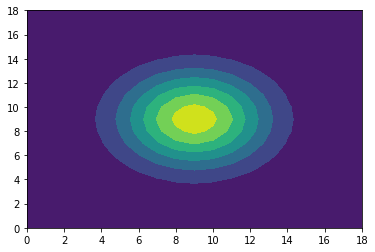

In [5]:
x, y = np.meshgrid(np.linspace(-1,1,19), np.linspace(-1,1,19))
d = np.sqrt(x*x+y*y)
sigma, mu = 0.3, 0
g = np.exp(-( (d-mu)**2 / ( 2.0 * sigma**2 ) ) )
plt.contourf(g)

check length 6 6


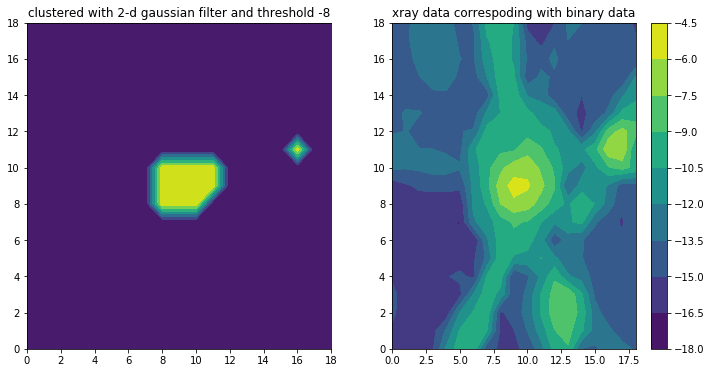

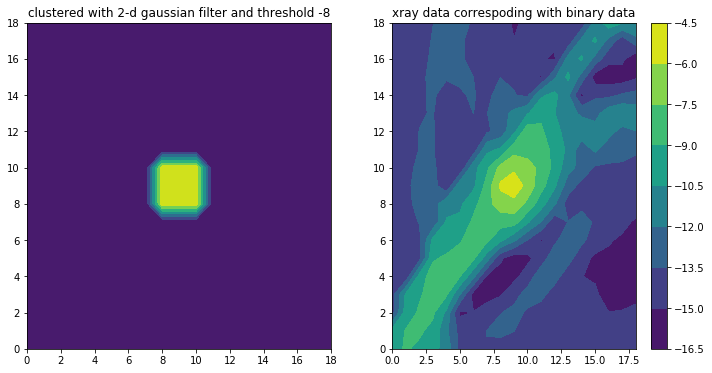

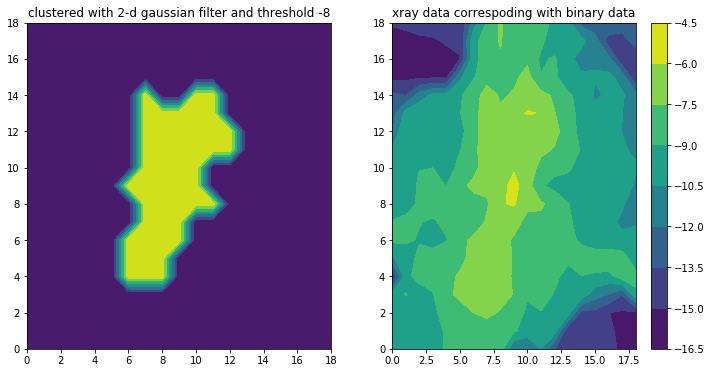

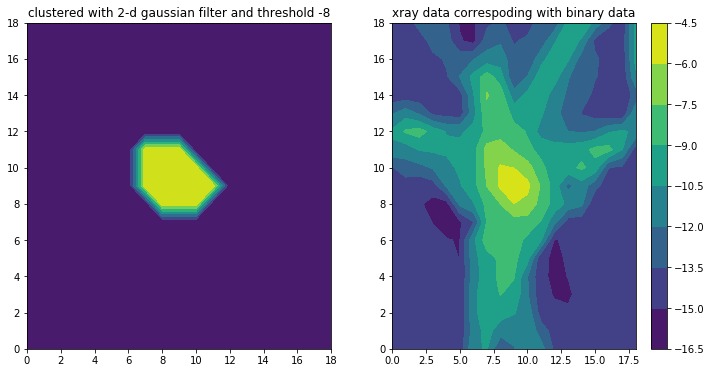

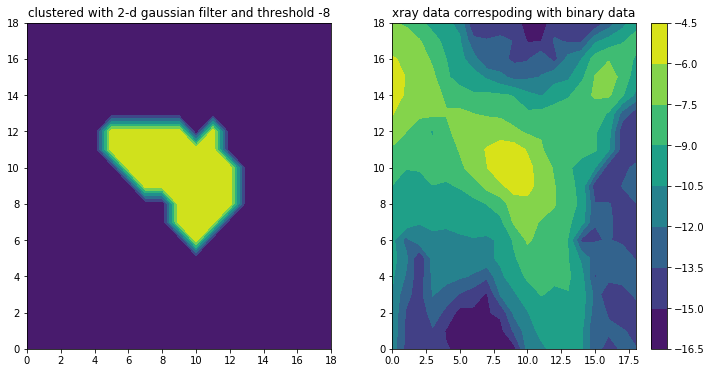

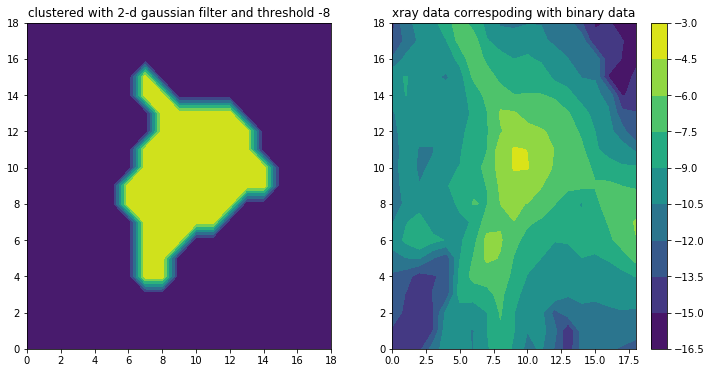

In [8]:

box_size = 24
threshold = -5.5
for sliced_index in range(0,255,255):
    xray_2d = xray_mat[:,:,sliced_index]
        
    xray_2d_log_volume = np.log10(xray_2d*volume_constant)
    #ray_2d_log_volume = np.log10(xray_2d)
    cluster_pics, ix_index, iy_index = cluster_crop(xray_2d_log_volume,box_size,threshold)
    
    cluster_pics_thres = copy.deepcopy(cluster_pics)
    cluster_pics_binary = np.zeros(cluster_pics.shape)

    for iz in range(cluster_pics.shape[2]):
        cluster_pics_thres[:,:,iz] = cluster_pics_thres[:,:,iz] + np.log10(g)
        for ix in range(box_size*2+1):
            for iy in range(box_size*2+1):
                if cluster_pics_thres[ix,iy,iz] > -8 :
                    cluster_pics_binary[ix,iy,iz] = 1
                else:
                    cluster_pics_binary[ix,iy,iz] = 0
                    
                    
        
        plt.figure(figsize= [12,6])
        plt.subplot(121)
        plt.contourf(cluster_pics_binary[:,:,iz])
        plt.title('clustered with 2-d gaussian filter and threshold -8')
        plt.subplot(122)
        plt.contourf(cluster_pics[:,:,iz])
        plt.title('xray data correspoding with binary data')
        title =  'sliced index z ' + str(sliced_index) + ' num = ' + str(iz)
        plt.colorbar()
        plt.show()
     #   save_result(save_dir,title)
    #np.save('z_' + str(sliced_index) + '_binary',cluster_pics_binary)
    #np.save('z_' + str(sliced_index)  ,cluster_pics)

check length 6 6
check length 7 7
check length 5 5


/home/ha/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


check length 8 8


/home/ha/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


check length 8 8
check length 7 7
check length 8 8
check length 19 19
check length 11 11
check length 7 7
check length 10 10
check length 12 12
check length 9 9
check length 5 5
check length 2 2
check length 9 9
check length 14 14
check length 14 14
check length 9 9
check length 12 12
check length 6 6
check length 7 7
check length 8 8
check length 7 7
check length 6 6
check length 7 7
check length 8 8
check length 13 13
check length 13 13
check length 8 8
check length 6 6
check length 7 7
check length 7 7
check length 9 9
check length 8 8
check length 5 5
check length 5 5
check length 4 4
check length 9 9
check length 8 8
check length 11 11
check length 5 5
check length 12 12
check length 4 4
check length 7 7
check length 10 10
check length 4 4
check length 11 11
check length 15 15
check length 19 19
check length 16 16
check length 8 8
check length 9 9
check length 10 10
check length 11 11
check length 8 8
check length 19 19
check length 20 20
check length 18 18
check length 11 11
chec

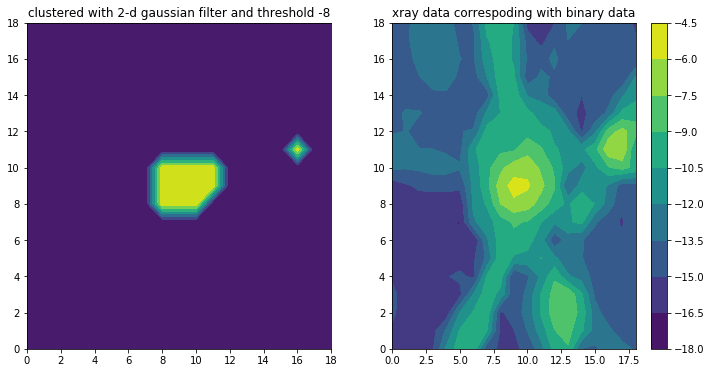

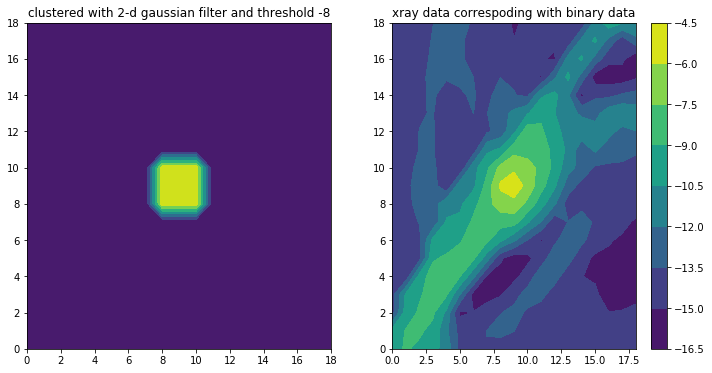

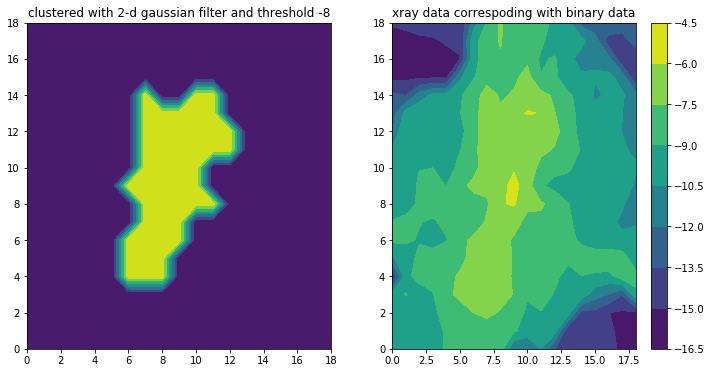

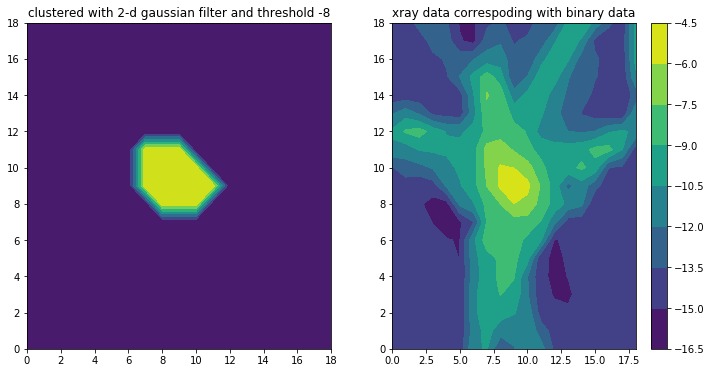

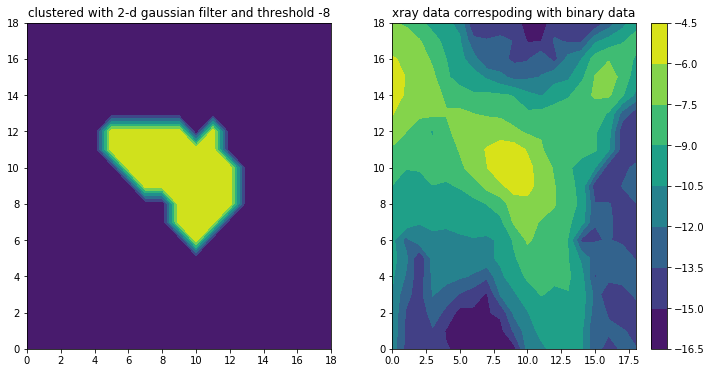

...

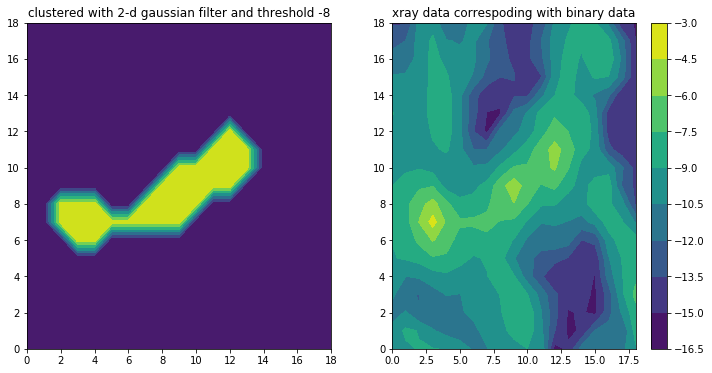

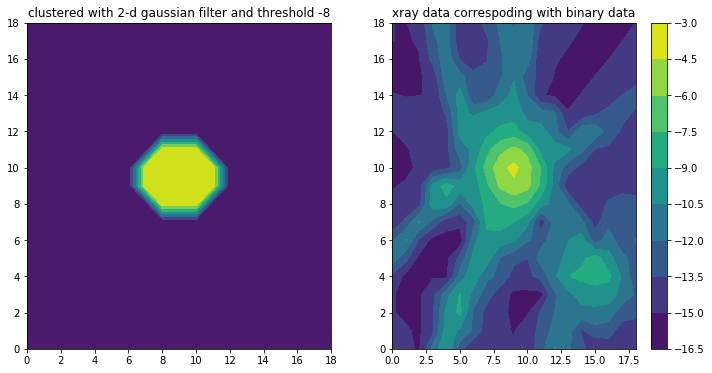

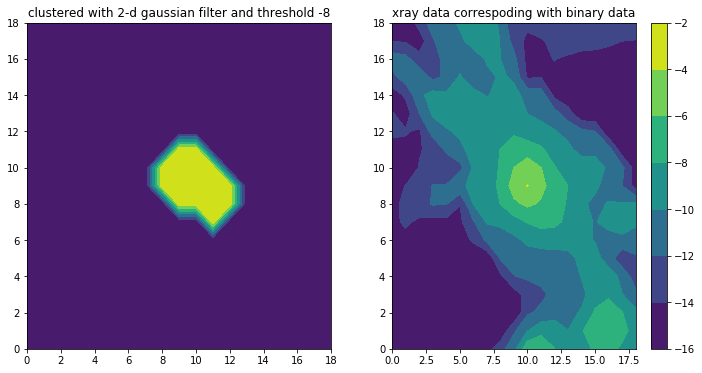

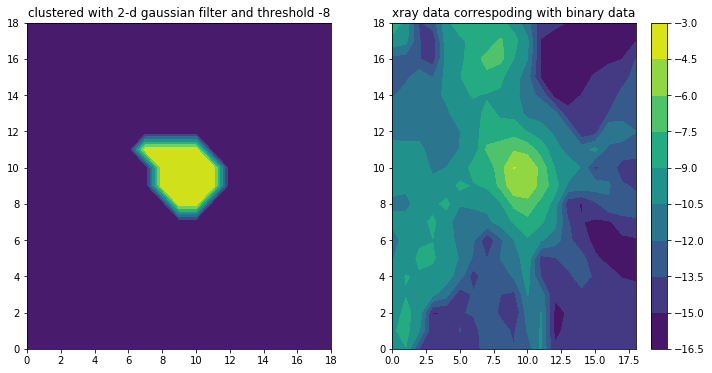

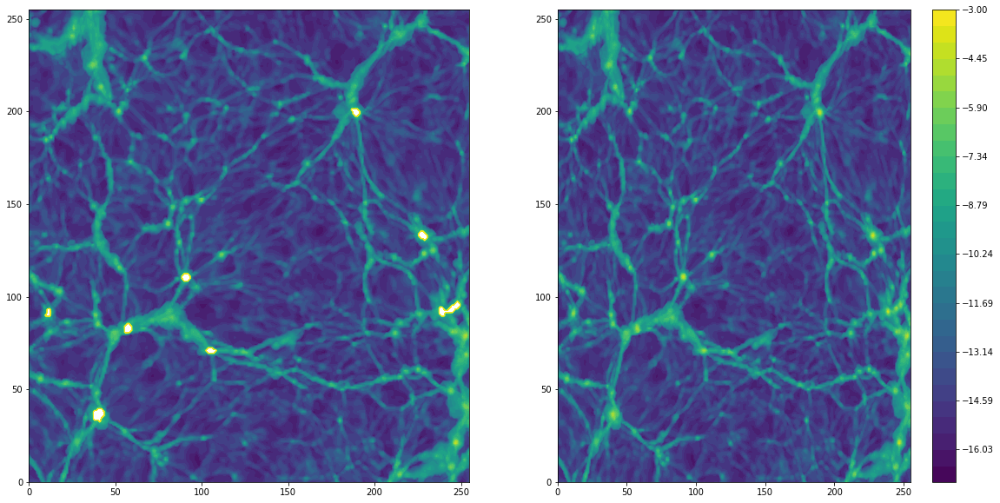

In [75]:
box_size = 9
threshold = -5.5
levels=np.linspace(-17,-3,30)

for sliced_index in range(0,255,4):
    if not os.path.isdir(save_dir + str(sliced_index) + '/'):
        os.mkdir(save_dir + str(sliced_index) + '/')
        
    os.chdir(save_dir + str(sliced_index) + '/')
    
    
    xray_2d = xray_mat[:,:,sliced_index]


    xray_2d_log_volume = np.log10(xray_2d*volume_constant)
    cluster_pics, ix_index, iy_index = cluster_crop(xray_2d_log_volume,box_size,threshold)

    cluster_pics_binary = np.zeros(cluster_pics.shape)
    cluster_pics_thres = copy.deepcopy(cluster_pics)
    cluster_whole = copy.deepcopy(xray_2d_log_volume)

    for iz in range(cluster_pics.shape[2]):
        cluster_pics_thres[:,:,iz] = cluster_pics_thres[:,:,iz] + np.log10(g)
        for ix in range(box_size*2+1):
            for iy in range(box_size*2+1):
                if cluster_pics_thres[ix,iy,iz] > -8 :
                    cluster_pics_binary[ix,iy,iz] = 1
                else:
                    cluster_pics_binary[ix,iy,iz] = 0
                        
                
                for nn,coords in enumerate(list(zip(ix_index,iy_index))):
                    if cluster_pics_binary[ix,iy,nn] == 1:
                        cluster_whole[coords[0]+ix-box_size,coords[1]+iy-box_size] = 1
                
            
        
       
        plt.figure(figsize= [12,6])
        plt.subplot(121)
        plt.contourf(cluster_pics_binary[:,:,iz])
        plt.title('clustered with 2-d gaussian filter and threshold -8')
        plt.subplot(122)
        plt.contourf(cluster_pics[:,:,iz])
        plt.title('xray data correspoding with binary data')
        title =  'Sliced index z = ' + str(sliced_index) + ' num = ' + str(iz)
        plt.colorbar()
        plt.savefig(title)
        dens
    plt.figure(figsize=[20,10])
    plt.subplot(121)
    plt.contourf(cluster_whole,levels)
    plt.subplot(122)
    plt.contourf(xray_2d_log_volume,levels)
    plt.clim(-17,-3)
    plt.colorbar()
    title = 'Sliced z = ' + str(sliced_index)
    plt.savefig(title)
#      #   save_result(s

In [74]:
cluster_pics.shape[2],len(ix_index),cluster_pics_binary.shape

(7, 7, (19, 19, 6))

In [41]:
for nn,ixx in enumerate(list(zip(ix_index,iy_index))):
    print(nn,ixx)

0 (54, 86)
1 (116, 96)
2 (144, 154)
3 (231, 117)
4 (234, 177)
5 (238, 166)


In [48]:
os.getcwd()

'/storage/filament/cluster_segmentation/2'

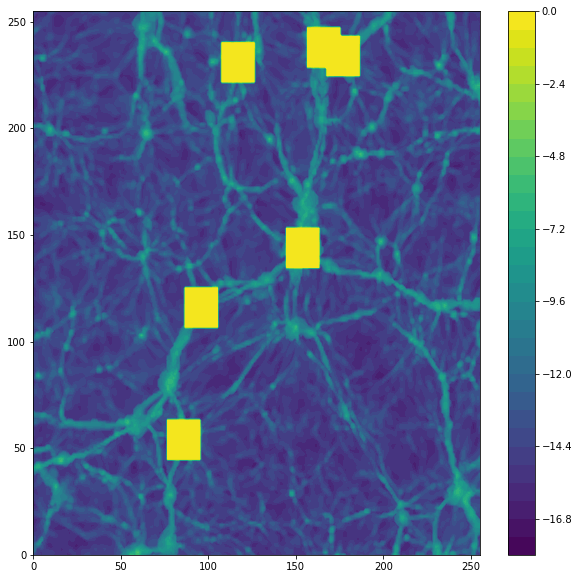

In [33]:
plt.figure(figsize=[10,10])
plt.contourf(cluster_whole,30)
plt.colorbar()
plt.show()